# Predicting AAPL stocks

To predict the stock price, we will look into the performance of the company. Variables to look at the performance of the company includes Assets, Liabilities, Dividend Yield, Profits. We will also look at the Federal interest Rates as an external factors on stock prices.

Variables used: Assets, Liabilities, Dividend Yield, Profits, Federal 
                Interest Rates and Price of stock

### The following are the reasons why we imported these library:
1. requests and json to extract the data from the Alpha Vantage.
2. pandas to extract data from csv file and do data preparation
3. numpy to process raw data to calculate the variables we want
4. seaborn and matplotlib for visualization of the data
5. datetime to convert the date to ordinal


In [1]:
#import all required libraries
import requests
import json
import pandas as pd
import seaborn as sb
import numpy as np
import matplotlib.pyplot as plt
import datetime as dt

### Data extracted:

**From API:**

1. BALSHT  : Balance Sheet for 2016 onwards. Extract Total Assets and Total Liabilities
2. INCSTAT : Income Shtatement from 2016 onwards. Extract Gross Profits
3. TSERIES : Stock Price since IPO of AAPL. Extract Adjusted Close Price and Dividends

**From Other sources throught a CSV/XLS file:**

4. bsolddf : Balance Sheet for 2009 onwards for more data points. Extract Total Assets and Total Liabilities
5. isolddf : Income Shtatement from 2009 onwards for more data points. Extract Gross Profits
6. interest: Federal Interest Rates from 2008-2021. Extract Interest Rates.

*For all dataframes, the index column will be the date*

In [2]:
#Extract balance sheet data for 2016 onwards from Alpha Vantage
BALSHT = requests.get('https://www.alphavantage.co/query?function=BALANCE_SHEET&symbol=AAPL&apikey=BNM3OK9KHBBVD3YZ') 
#Extract income statement data for 2016 onwards from Alpha Vantage
INCSTAT = requests.get('https://www.alphavantage.co/query?function=INCOME_STATEMENT&symbol=AAPL&apikey=BNM3OK9KHBBVD3YZ')
#Extract TimeSeries data since Initial Public Offering (IPO) from Alpha Vantage
TSERIES = requests.get('https://www.alphavantage.co/query?function=TIME_SERIES_DAILY_ADJUSTED&symbol=aapl&outputsize=full&apikey=BNM3OK9KHBBVD3YZ') 

#Extract balance sheet data for older years (2009 - 2015) from Advisor Tools
bsolddf = pd.read_excel("AAPL BAL SHEET.xls") 
#Extract income sheet data for older years (2009 - 2015) from Advisor Tools
isolddf = pd.read_excel("AAPL INCOME SHEET.xls") 
#Extract daily federal interest rates from St. Louis Fred 
interest = pd.read_csv('FEDFUNDS.csv',index_col=0) 

In [3]:
#Transform API requested data from json into pandas dataframes
bsdata = BALSHT.text
bsparsed = json.loads(bsdata)
bsquartdata = bsparsed['quarterlyReports']
bsquartdf = pd.DataFrame.from_dict(bsquartdata)

isdata = INCSTAT.text
isparsed = json.loads(isdata)
isquartdata = isparsed['quarterlyReports']
isquartdf = pd.DataFrame.from_dict(isquartdata)

data = TSERIES.text
parsed = json.loads(data)
tsdata = parsed['Time Series (Daily)']
#Setting the date as the index of the dataframe
tsda = pd.DataFrame.from_dict(tsdata, orient='index')
tsda_new=tsda.loc[:'2009-01-02',]

### Extracting price

We used the adjusted close price for the price of the stock as the data is adjusted according to all the stock split AAPL has experienced. In order to extract the adjusted close price, we use TimeSeries data from the Alpha Vantage API.


In [4]:
#Extracting price variable from TimeSeries dataframe
price=tsda_new.drop(['1. open','2. high','3. low','4. close','6. volume','7. dividend amount','8. split coefficient'],1)
price.rename(columns={"5. adjusted close":"price"},inplace=True)
price.price = pd.to_numeric(price.price)
price.index = pd.to_datetime(price.index)
price.head()

,price
2021-04-22,131.94
2021-04-21,133.50
2021-04-20,133.11
2021-04-19,134.84
2021-04-16,134.16


### Extracting Dividend Yield

Dividend yield is defined as the financial ratio that shows how much a company pays out in dividend relative to its stock price. 

1. To calculate adjusted dividends, we divide the dividends from the Alpha Vantage API according to the stock split history
2. To extract dividend yield, we divided the adjusted dividend by the adjusted stock price on the same day the dividends was given 

The final product is the dividend_yield column as shown in the dataframe dividend below.

In [5]:
#Extracting dividend variable from TimeSeries dataframe
dividend=tsda_new.drop(['1. open','2. high','3. low','5. adjusted close','6. volume','8. split coefficient'],1)
dividend.rename(columns={"4. close":"price","7. dividend amount":"adjusted_dividend"},inplace=True)

#Cleaning of dividend data
dividend.adjusted_dividend = pd.to_numeric(dividend.adjusted_dividend)
dividend.price = pd.to_numeric(dividend.price)
dividend.index = pd.to_datetime(dividend.index)
#dividend.index=dividend.index.map(dt.datetime.toordinal)

#remove zeroes
indexNames = dividend[ dividend['adjusted_dividend'] == 0 ].index
dividend.drop(indexNames , inplace=True)

#Account for stock split
#To account for 4-1 stock split in 2020. 
dividend_before_2020=dividend.loc['2020-08-07':,]
dividend_before_2020=(dividend_before_2020)/4
#To account for 7-1 stock split in 2014
dividend_before_2014=dividend_before_2020.loc['2014-05-08':,]
dividend_before_2014=dividend_before_2014/7
#Updating the dividend dataframe accordingly
dividend.update(dividend_before_2020)
dividend.update(dividend_before_2014)
#Calculating the dividend yield for the stock price at that point of time
dividend['dividend_yield'] = dividend['adjusted_dividend']/dividend['price']*100
dividend = dividend.drop(['price'],1)
dividend.head()

,adjusted_dividend,dividend_yield
2021-02-05,0.2050,0.149898
2020-11-06,0.2050,0.172719
2020-08-07,0.2050,0.184498
2020-05-08,0.2050,0.264405
2020-02-07,0.1925,0.240602


### Extracting Federal Interest Rates

To extract the interest rates, we first set the index of the date column of the data frame. This is for easier updating to the main dataframe later in the code. Data is available until the end of April 2021. 

In [6]:
#extracting fed_interest variable from federal interest dataframe
interest.index = pd.to_datetime(interest.index)
#interest.index = interest.index.map(dt.datetime.toordinal)
interest = interest.drop(interest.columns[1:], axis=1)
interest.head()

,fed_interest
index,
2021-05-02,NaN
2021-05-01,NaN
2021-04-30,0.07
2021-04-29,0.07
2021-04-28,0.07


### Adding columns to the price dataframe and processing

We first create two new columns for interest rates and dividends. We will then update the interest rates and the dividends yield to the main dataframe. Subsequently, for every empty information in the data, we extrapolate the data points to match the number of data for the prices. This is to add data points for a more detailed analysis on the price of the stock, as well as to facilitate the multivariate regression which was done later in the notebook.

In [7]:
#Adding variables to the dataframe
price['fed_interest'] = np.nan
price['dividend_yield'] = np.nan
price.update(interest)
price.update(dividend)

#Extrapolating daily data points for quarterly dividend yield
div=0
date=4417
i=price.shape[0]-1
for date in price.index:
    if pd.isnull(price.iloc[i,2]):
        price.iloc[i,2]=div
        i-=1
    else:
        div=price.iloc[i,2]
        i-=1

price.index.names = ['Date']
price.head()

,price,fed_interest,dividend_yield
Date,,,
2021-04-22,131.94,0.07,0.149898
2021-04-21,133.50,0.07,0.149898
2021-04-20,133.11,0.07,0.149898
2021-04-19,134.84,0.07,0.149898
2021-04-16,134.16,0.07,0.149898


### Natural log of price

To look at how well the company has been growing, a logaritmic graph will be used to check the trend of that graph. To analyze such a data, we decided to create a new column for the natural log of the price. This will show the kind of growth the company is experiencing.

In [8]:
#Adding lnprice variable to dataframe
price['lnprice'] = np.log(price['price'])
price.head()

,price,fed_interest,dividend_yield,lnprice
Date,,,,
2021-04-22,131.94,0.07,0.149898,4.882347
2021-04-21,133.50,0.07,0.149898,4.894101
2021-04-20,133.11,0.07,0.149898,4.891176
2021-04-19,134.84,0.07,0.149898,4.904089
2021-04-16,134.16,0.07,0.149898,4.899033


### Extracting Assets and Liabilities 

To extract the assets and liabilities, we will extract the data from both the csv file and the Alpha Vantage API. 

1. Use two data frame to extract both the old data from the XLS and the API.
2. Combine both the data frmaes together using a for loop
3. After checking the data, clean the data

The data has 4 abormalies. After crosschecking with the Apple website, we decided to update these abnormalies as the data given from the API is wrong. Hence the manual update of the dataframe.

In [9]:
#Extracting totalAssets and totalLiabilties variables from balance sheet 
#dataframe (API)
assets_liab_new = bsquartdf[['fiscalDateEnding', 'totalAssets', 'totalLiabilities']]
assets_liab_new[['totalAssets', 'totalLiabilities']] = assets_liab_new[['totalAssets', 'totalLiabilities']].apply(pd.to_numeric)

#Extracting totalAssets and totalLiabilties variables from old balance 
#sheet dataframe (XLS)
assets_liab_old = bsolddf[['Period End Date', 'TOTAL ASSETS', 'TOTAL LIABILITIES']]

#Combining both dataframes into one dataframe
new_cols = {x: y for x, y in zip(assets_liab_old.columns, assets_liab_new.columns)}
assets_liab = assets_liab_new.append(assets_liab_old.rename(columns=new_cols))
assets_liab.set_index('fiscalDateEnding', inplace=True)
assets_liab.index = pd.to_datetime(assets_liab.index)

#Fixing anomalies in api generated data manually. Data from Apple.
assets_liab.loc['2019-06-30', 'totalLiabilities'] = 225783000000
assets_liab.loc['2019-03-31', 'totalLiabilities'] = 236138000000
assets_liab.loc['2018-12-31', 'totalLiabilities'] = 255827000000
assets_liab.loc['2018-09-30', 'totalLiabilities'] = 258578000000

assets_liab.head()

C:\Users\chink\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


,totalAssets,totalLiabilities
fiscalDateEnding,,
2020-12-31,354054000000,287830000000
2020-09-30,323888000000,258549000000
2020-06-30,317344000000,245062000000
2020-03-31,320400000000,241975000000
2019-12-31,340618000000,251087000000


### Extracting Gross Profits

Similar to that of the Assets and Liabilities. Gross Profits do not have any abnormalies.

In [10]:
#extracting grossProfit variable from income sheet dataframe (API)
profits_new = isquartdf[['fiscalDateEnding', 'grossProfit']]
profits_new.grossProfit = pd.to_numeric(profits_new.grossProfit)

#extracting grossProfit variable from old income sheet dataframe (XLS)
profits_old = isolddf[['Period End Date', 'Gross Profit']]

#combining both dataframes into one dataframe
new_cols = {x: y for x, y in zip(profits_old.columns, profits_new.columns)}
profits = profits_new.append(profits_old.rename(columns=new_cols))
profits.set_index('fiscalDateEnding', inplace=True)
profits.index = pd.to_datetime(profits.index)

profits.head()

C:\Users\chink\anaconda3\lib\site-packages\pandas\core\generic.py:5168: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


,grossProfit
fiscalDateEnding,
2020-12-31,44328000000
2020-09-30,24689000000
2020-06-30,22680000000
2020-03-31,22370000000
2019-12-31,35217000000


### Consolidating Assets, Liabilities and Profits

A new data frame is created to compile all the data into one dataframe for easy reference. Similar to that of dividends, for every empty information in the data, we extrapolate the data points to match the number of data for the prices to facilitate the multivariate regression.

In [11]:
#combining totalAssets, totalLiabilities and grossProfit variables into 
#one dataframe
db_clean = pd.DataFrame({'Date': pd.to_datetime(tsda_new.index), 'totalAssets': np.nan, 'totalLiabilities': np.nan, 'grossProfit': np.nan})
#db_clean['Date_Ordinal'] = pd.to_datetime(db_clean['Date_Ordinal'])
db_clean = db_clean.set_index('Date')
#db_clean.index = db_clean.index.map(dt.datetime.toordinal)

#extrapolating daily data points for quarterly totalAssets, 
#totalLiabilities and grossProfit data
i = 0
date = assets_liab.index[i]

for d in db_clean.index:
    if d >= date:
        db_clean.loc[d, 'totalAssets'] = assets_liab.iloc[i, 0]
        db_clean.loc[d, 'totalLiabilities'] = assets_liab.iloc[i, 1]
        db_clean.loc[d, 'grossProfit'] = profits.iloc[i, 0]
    else:
        i = i+1
        date = assets_liab.index[i]
        db_clean.loc[d, 'totalAssets'] = assets_liab.iloc[i, 0]
        db_clean.loc[d, 'totalLiabilities'] = assets_liab.iloc[i, 1]
        db_clean.loc[d, 'grossProfit'] = profits.iloc[i, 0]

db_clean.head()

,totalAssets,totalLiabilities,grossProfit
Date,,,
2021-04-22,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-21,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-20,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-19,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-16,3.540540e+11,2.878300e+11,4.432800e+10


### Combining the two dataframes into a main dataframe

A main data frame is created to combine everything for data comparison. We first use the dataframe price as it has all the price data points, then we updated the assets, liabilities and profits into the main dataframe.

To analyse the data and do multivariate regression, we created a new columns for the date and converted it into the ordinal form. Ordinal form of the date refers to a numeric value that shows the number of days from the year 0.

In [12]:
#merging totalAssets, totalLiabilities and grossProfit variables with price, fed_interest, dividend_yield and lnprice variables
merged = price.copy(deep=True)
merged['totalAssets'] = np.nan
merged['totalLiabilities'] = np.nan
merged['grossProfit'] = np.nan
merged.update(db_clean)

#insert dateOrd variable (ordinal value of date value)
merged.insert(0, "dateOrd", merged.index.map(dt.datetime.toordinal))
#extract Date variable from index for processing later
merged.insert(0, "Date", merged.index)
merged.head()

,Date,dateOrd,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit
Date,,,,,,,,,
2021-04-22,2021-04-22,737902,131.94,0.07,0.149898,4.882347,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-21,2021-04-21,737901,133.50,0.07,0.149898,4.894101,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-20,2021-04-20,737900,133.11,0.07,0.149898,4.891176,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-19,2021-04-19,737899,134.84,0.07,0.149898,4.904089,3.540540e+11,2.878300e+11,4.432800e+10
2021-04-16,2021-04-16,737896,134.16,0.07,0.149898,4.899033,3.540540e+11,2.878300e+11,4.432800e+10


In [13]:
merged.describe()

,dateOrd,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit
count,3097.000000,3097.000000,3097.000000,3097.000000,3097.000000,3.097000e+03,3.097000e+03,3.097000e+03
mean,735655.010010,32.202274,0.543371,0.303533,3.117906,2.326218e+11,1.355928e+11,1.856278e+10
std,1297.670715,29.189666,0.717526,0.223061,0.862173,1.121831e+11,9.121652e+10,8.870531e+09
min,733409.000000,2.405355,0.050000,0.000000,0.877698,4.278700e+10,1.586100e+10,3.627000e+09
25%,734532.000000,12.972001,0.100000,0.000000,2.562793,1.386810e+11,4.843600e+10,1.302400e+10
50%,735656.000000,23.237589,0.160000,0.387083,3.145771,2.611940e+11,1.321880e+11,1.968100e+10
75%,736779.000000,41.476547,0.650000,0.451663,3.725128,3.311410e+11,2.342480e+11,2.268000e+10
max,737902.000000,142.945728,2.420000,0.667732,4.962465,4.067940e+11,2.878300e+11,4.432800e+10


### Feature Scaling

The ranges of our independent variables are very different from each other. To improve the accuracy of the model, we did some feature scaling on the data. Feature scaling refers to the method to normalize the range of the independent variables.  

To do feature scaling we:

1. Determine the feature range that we want to use
2. Implement the scaling using the functions
3. Check the dataframe



In [14]:
#Feature scaling for totalAssets, totalLiabilities, grossProfit and 
#dateOrd variables
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(1, 5))
scaler1 = MinMaxScaler(feature_range=(0, 1))

merged['dateOrd'] = merged['dateOrd'] - 733409

merged[['totalAssets', 'totalLiabilities', 'grossProfit']] = scaler.fit_transform(merged[['totalAssets', 'totalLiabilities', 'grossProfit']].values)

merged[['dateOrd']] = scaler1.fit_transform(merged[['dateOrd']])

In [15]:
merged.describe()

,dateOrd,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit
count,3097.000000,3097.000000,3097.000000,3097.000000,3097.000000,3097.000000,3097.000000,3097.000000
mean,0.499891,32.202274,0.543371,0.303533,3.117906,3.086056,2.760962,2.467854
std,0.288821,29.189666,0.717526,0.223061,0.862173,1.232758,1.341572,0.871775
min,0.000000,2.405355,0.050000,0.000000,0.877698,1.000000,1.000000,1.000000
25%,0.249944,12.972001,0.100000,0.000000,2.562793,2.053760,1.479099,1.923515
50%,0.500111,23.237589,0.160000,0.387083,3.145771,3.400031,2.710886,2.577750
75%,0.750056,41.476547,0.650000,0.451663,3.725128,4.168664,4.211940,2.872485
max,1.000000,142.945728,2.420000,0.667732,4.962465,5.000000,5.000000,5.000000


### Bivariate data visualization

The following is the graphs for all the variables against time. The following are the observed trends:

1. Stock price has seen exponential price increase. 
2. Natural Log of price shows a linear relationship, showing constant growth
3. Liabilities, Assets and profits are increasing over time
4. Federal interest rates do not follow any trend 

Text(0.5, 1.0, 'Profits')

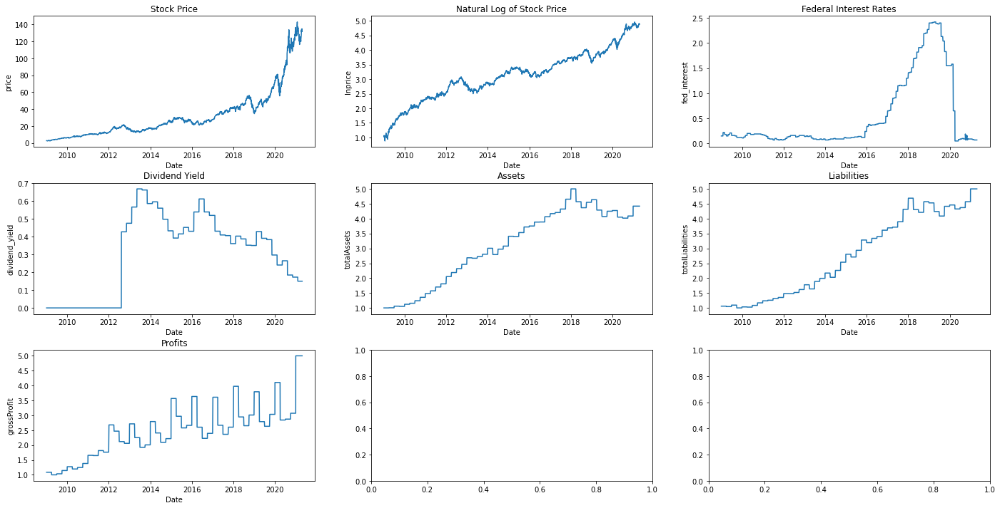

In [16]:
#univariate data visualizations for all variables
f, axes = plt.subplots(3, 3, figsize=(24, 12))
plt.subplots_adjust(hspace = 0.275)
sb.lineplot(data = merged, x='Date', y='price', ax=axes[0,0]).set_title('Stock Price')
sb.lineplot(data = merged, x='Date', y='lnprice', ax=axes[0,1]).set_title('Natural Log of Stock Price')
sb.lineplot(data = merged, x='Date', y='fed_interest', ax=axes[0,2]).set_title('Federal Interest Rates')
sb.lineplot(data = merged, x='Date', y='dividend_yield', ax=axes[1,0]).set_title('Dividend Yield')
sb.lineplot(data = merged, x='Date', y='totalAssets', ax=axes[1,1]).set_title('Assets')
sb.lineplot(data = merged, x='Date', y='totalLiabilities', ax=axes[1,2]).set_title('Liabilities')
sb.lineplot(data = merged, x='Date', y='grossProfit', ax=axes[2,0]).set_title('Profits')

### Correlation Matrix

To analyze how each of the variables interact with each other, we created a correlation matrix to show how linearly related to each other. These are some of the trends we ovbserved:

1. Interest rates is the least linearly related to many of the variables
2. All except Interest rates and Dividend Yields are strong related to the date
3. ln price is more stronly linearly related to all the data compared to price.

<AxesSubplot:>

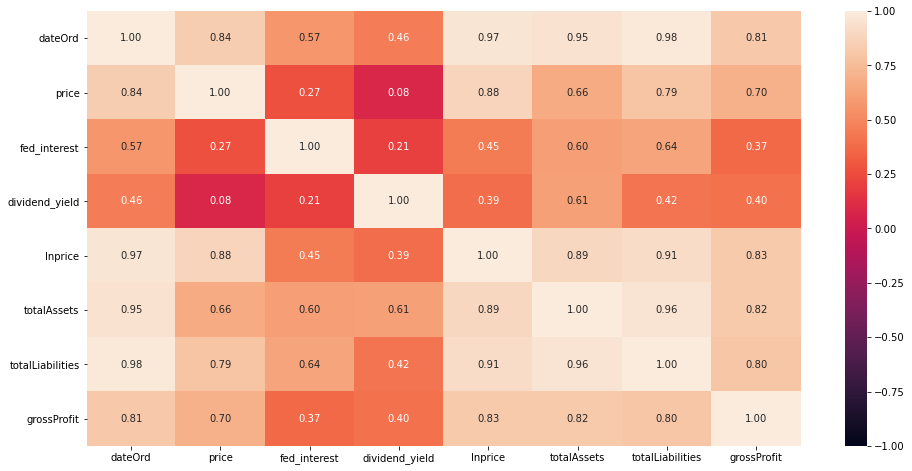

In [17]:
#Correlation matrix
f = plt.figure(figsize=(16, 8))
sb.heatmap(merged.corr(), vmin = -1, vmax = 1, annot = True, fmt=".2f")

### Pairplot

The following shows all the data points and how they will look like when plotted against each other.

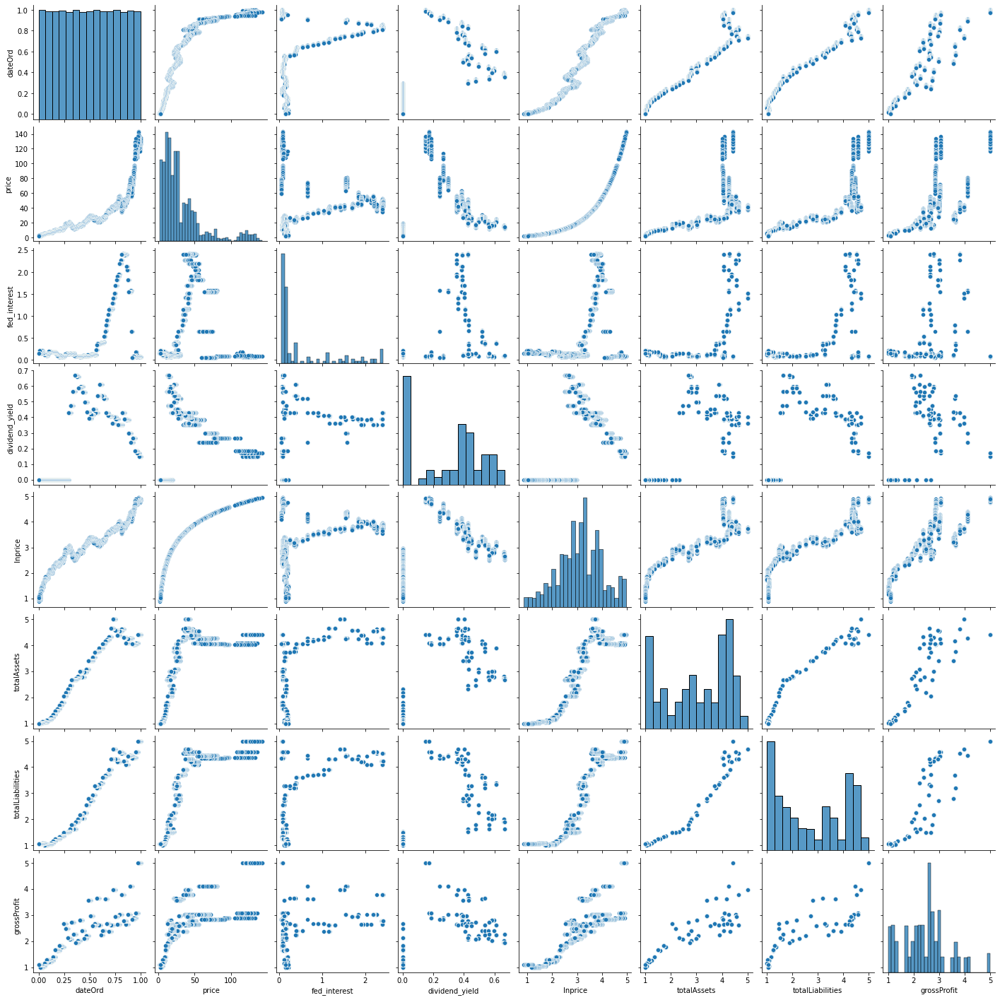

In [18]:
#Pairplot for all variables
sb.pairplot(merged)

## Machine Learning

### Multivariate Linear Regression

We are going to create a multivariate regression model to predict the stock price. Details are as follows.

#### Variables

Dependent Variable   : Natural Log of Stock Price

Independent variables: Time, Interest Rates, Dividend Yield, Assets,     
                       Liabilities, Profits

#### Test Train data

Train data will be data from the past, so in this case it would be data from 2009-2018. Test data will be data from 2018 onwards to check with the most recent price movement and try to compare that with the prediction of the model.


In [19]:
#Prepare X and y dataframes for linear regression
y = pd.DataFrame(merged['lnprice'])
X = pd.DataFrame(merged[['dateOrd', 'fed_interest', 'dividend_yield', 'totalAssets', 'totalLiabilities', 'grossProfit']])

#Split X and y dataframes into test (25%) and train (75%) sets
X_test = X[0:int(0.25*X.shape[0])]
X_train = X[int(0.25*X.shape[0]):]
y_test = y[0:int(0.25*X.shape[0])]
y_train = y[int(0.25*X.shape[0]):]

### Results of Multivariate Regression

#### Actual Test Data vs Predicted Value

The Actual test data is not too far away from the Predicted value, making the model rather accurate as it follows a linear regression.



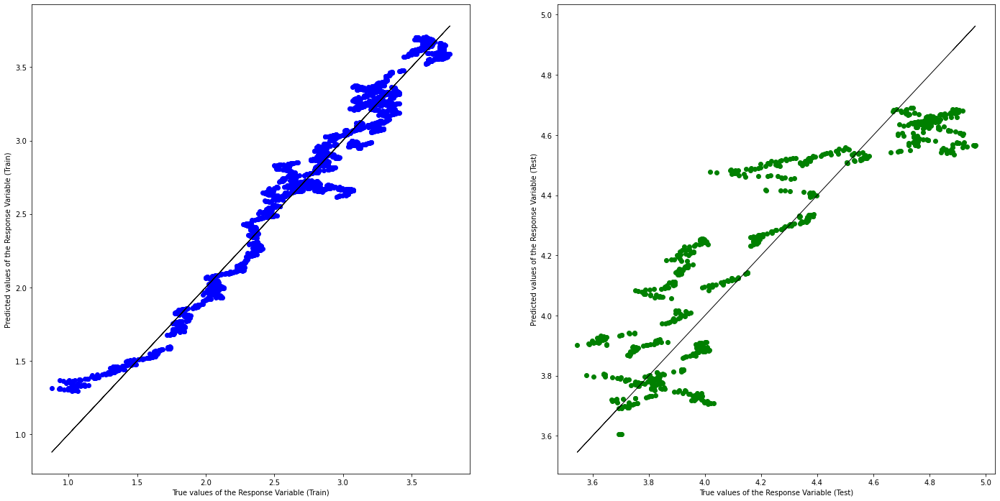

In [20]:
#perform multivariate linear regression
from sklearn.linear_model import LinearRegression

linreg = LinearRegression()
linreg.fit(X_train, y_train)

y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

#plot true values against predicted values
f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")
axes[0].plot(y_train, y_train, 'k-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")
axes[1].plot(y_test, y_test, 'k-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

#### To visualize the data

We exponential the natural log of the price after predicting to see how our data fares when tring to predict the actual stock price, and how well it can predict the natural log of the stock price itself. Fluctuation seem to be larger as time passes. Trend of the predictor seem to follow the price movements of the stock price.

<AxesSubplot:xlabel='Date', ylabel='Price'>

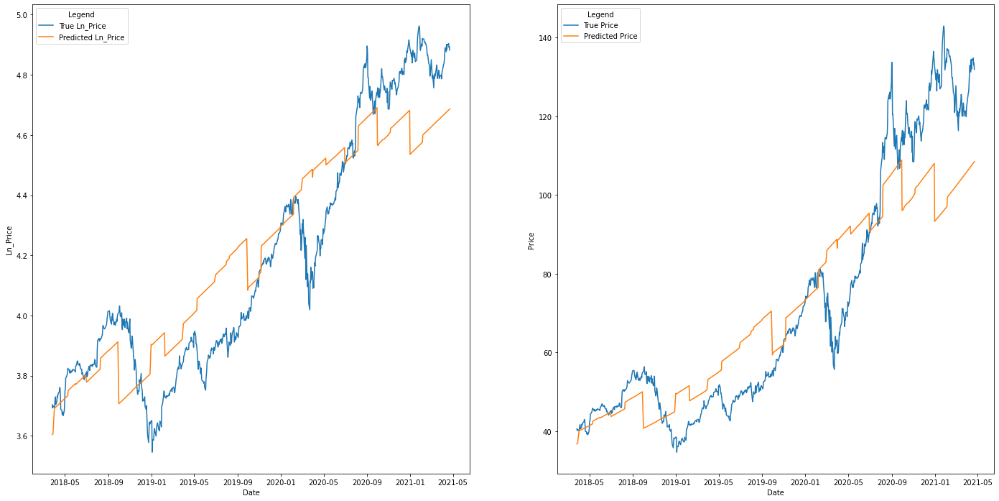

In [21]:
#visualize predicted and true values of price and lnprice
results = pd.concat([y_test, pd.DataFrame(y_test_pred, columns=['lnprice_pred']).set_index(y_test.index), pd.DataFrame(y_test.index).set_index(y_test.index)], axis = 1)
results.rename(columns={'lnprice': 'True Ln_Price', 'lnprice_pred': 'Predicted Ln_Price'}, inplace=True)
results1 = results.copy(deep=True)
results1['True Price'] = np.exp(results['True Ln_Price'])
results1['Predicted Price'] = np.exp(results['Predicted Ln_Price'])
results1 = results1.drop(['True Ln_Price', 'Predicted Ln_Price'], 1)
resultsmelt = pd.melt(results, 'Date', var_name='Legend', value_name='Ln_Price')
resultsmelt1 = pd.melt(results1, 'Date', var_name='Legend', value_name='Price')

f, axes = plt.subplots(1, 2, figsize=(24, 12))
sb.lineplot(x=resultsmelt.Date, y='Ln_Price', hue='Legend', data = resultsmelt, ax=axes[0])
sb.lineplot(x=resultsmelt1.Date, y='Price', hue='Legend', data = resultsmelt1, ax=axes[1])

#### Coefficients of model

The following shows the properties of the model. 

Intercept refers to the number when the values for all variables are 0. 

The coefficient of the multivariate regression shows how important each variable is. In this case, the date has the largest influence on the model, since its coefficient is the largest in magnitude. The sign shows how the variables affect the prediction. If the coefficient is negative, it shows an inverse relationship and vice versa.

In [22]:
#Print intercept and coefficients of linear regression model
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()
pd.DataFrame(list(zip(X_train.columns, linreg.coef_[0])), columns = ["Predictors", "Coefficients"])

Intercept of Regression 	: b =  [1.67738215]
Coefficients of Regression 	: a =  [[ 5.09565178 -0.03559453 -1.00320128  0.46131282 -0.82240849  0.02783759]]



,Predictors,Coefficients
0,dateOrd,5.095652
1,fed_interest,-0.035595
2,dividend_yield,-1.003201
3,totalAssets,0.461313
4,totalLiabilities,-0.822408
5,grossProfit,0.027838


#### Accuracy of the Model

The explained variance and the adjusted explained variance are relatively high when trying to predict the stock price from 2018-2021, and the two values are very close to each other.

The root mean squared error is relatively low, showing that the prediction is not too far from the actual data. 

**Explanation why we use Adjusted Explained Variance**

In a multivariate regression, as we add more independent variables to produce the model for the stock price, the explained variance will always increase. This could lead to the problem of overfitting. In order to detect it, we used adjusted explained variance. The adjusted explained variance helps to show how useful the variables are when it comes to the prediction. If the difference between these two values is big, it shows that the model is overfitted.  

Hence, our model is relatively accurate in trying to predict the stock price and model is not overfitted.

In [23]:
#Print performance measures for linear regression model
from sklearn.metrics import mean_squared_error

print("Goodness of Fit of Model \t\tTrain Dataset")
print("Explained Variance (R^2) \t\t:", linreg.score(X_train, y_train))
print("Adjusted Explained Variance (R^2) \t:", (1 - (1 - linreg.score(X_train, y_train)) * ((X_train.shape[0] - 1) / (X_train.shape[0] - X_train.shape[1] - 1))))
print("Root Mean Squared Error (RMSE) \t\t:", mean_squared_error(y_train, y_train_pred, squared=False))
print()

print("Goodness of Fit of Model \t\tTest Dataset")
print("Explained Variance (R^2) \t\t:", linreg.score(X_test, y_test))
print("Adjusted Explained Variance (R^2) \t:", (1 - (1 - linreg.score(X_test, y_test)) * ((X_test.shape[0] - 1) / (X_test.shape[0] - X_test.shape[1] - 1))))
print("Root Mean Squared Error (RMSE) \t\t:", mean_squared_error(y_test, y_test_pred, squared=False))
print()

Goodness of Fit of Model 		Train Dataset
Explained Variance (R^2) 		: 0.9617669399679395
Adjusted Explained Variance (R^2) 	: 0.9616678905896181
Root Mean Squared Error (RMSE) 		: 0.12724089955359702

Goodness of Fit of Model 		Test Dataset
Explained Variance (R^2) 		: 0.8087175956856506
Adjusted Explained Variance (R^2) 	: 0.8072212535397756
Root Mean Squared Error (RMSE) 		: 0.1769645882317882

